Python実践データ分析100本ノック（秀和システム）の勉強記録を載せています。<br>
問題の解説、コードを載せています。参考になれば幸いです。<br>
わからない点等ございましたらコメントお願いします。¶

# 第9章 潜在顧客を把握するための画像認識10本ノック

> ### 注 : 今回は画像処理ライブラリとしてOpenCVを使用するが、実際の画像認識ではディープラーニング（ResNet、YOLOなど）を用いるのが一般的。

小売店の前を通る道路の動画/画像を扱う。画像を分析することで時間帯による人通りの多さなどを分析する。

# ノック81 : 画像データを読み込む

画像幅 : 1920
画像高さ : 1440


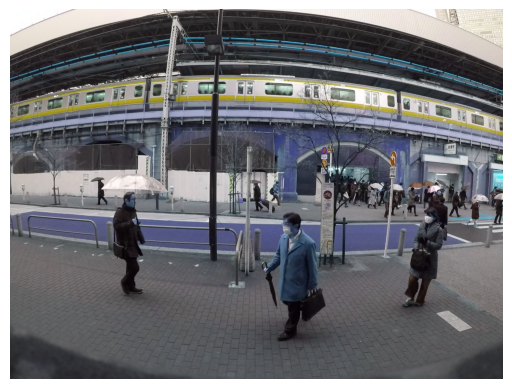

In [1]:
import cv2
# kaggle notebook上ではcv2_imshowを使えないので
# plt.imshowで代用
# cv2.imshowでも大丈夫らしい
import matplotlib.pyplot as plt 

img = cv2.imread('../input/100knock-opencv/img01.jpg')
height, width = img.shape[:2]
print('画像幅 : ' + str(width))
print('画像高さ : ' + str(height))



# 画像を表示
plt.imshow(img)
plt.axis('off')  # 軸を表示しない
plt.show()

# ノック82 : 映像データを読み込む

In [2]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# 情報取得
cap = cv2.VideoCapture('../input/100knock-opencv/mov01.avi')

# 縦横、総フレーム数、FPSに関する情報取得
width = cap.get(cv2.CAP_PROP_FRAME_WIDTH)
height = cap.get(cv2.CAP_PROP_FRAME_HEIGHT)
count = cap.get(cv2.CAP_PROP_FRAME_COUNT)
fps = cap.get(cv2.CAP_PROP_FPS)
print('画像幅 : ' + str(width))
print('画像高さ : ' + str(height))
print('総フレーム数 : ' + str(count))
print('FPS : ' + str(fps))

画像幅 : 1920.0
画像高さ : 1440.0
総フレーム数 : 401.0
FPS : 30.0


Video file opened successfully.
Total frames captured: 102


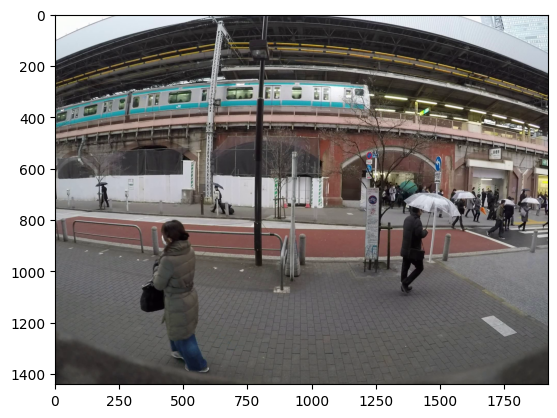

In [3]:
# 映像キャプチャを開く
cap = cv2.VideoCapture('../input/100knock-opencv/mov01.avi')

# ファイルがひらけているかどうか確認する
if not cap.isOpened():
    print("Error: Video file could not be opened.")
else:
    print("Video file opened successfully.")
    

num = 0
num_frame = 100
list_frame = []

while cap.isOpened():
    ret, frame = cap.read()
    
    if ret:
        frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        plt.imshow(frame_rgb)
        list_frame.append(frame_rgb)
        
        if num > num_frame:
            break
    else:
        break
    
    num += 1

cap.release()
print(f"Total frames captured: {len(list_frame)}")


In [4]:
# フレーム画像をアニメーションに変換
plt.figure()
patch = plt.imshow(list_frame[0])
plt.axis('off')
def animate(i):
    patch.set_data(list_frame[i])
anim = FuncAnimation(plt.gcf(), animate, frames=len(list_frame), interval=1000/30.0)
plt.close()

# アニメーションを表示
HTML(anim.to_jshtml())

> #### 動いてる！すごい！ありがとうChatGPT！

# ノック83 : 映像を画像に分割して保存する

In [5]:

cap = cv2.VideoCapture('../input/100knock-opencv/mov01.avi')
num = 0
count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

while cap.isOpened():
    ret, frame = cap.read()
    if ret:
        # 分割した画像の保存先
        filepath = './snapshot_' + str(num) + '.jpg'
        cv2.imwrite(filepath, frame)
    else:
        break  # フレームの読み込みに失敗した場合はループを抜ける
    
    num += 1
    if num >= count:
        break

cap.release()

# ノック84 : 画像内のどこに人がいるのかを検出してみる

#### 人の認識を行うには、「HOG特徴量」を使用する。HOG = Histogram of Oriented Gradients（輝度勾配）。<br>単純には「人のシルエットを見て、そのシルエットの形の特徴を、位置や角度で表現するもの」

True

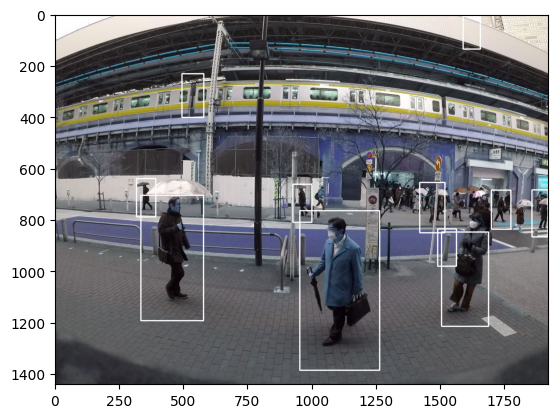

In [6]:
# 準備 #
hog = cv2.HOGDescriptor()
hog.setSVMDetector(cv2.HOGDescriptor_getDefaultPeopleDetector())
hogParams = {'winStride': (8, 8), 'padding': (32, 32), 'scale': 1.05, 'hitThreshold':0, 'groupThreshold':5}

# 検出 #
img = cv2.imread("../input/100knock-opencv/img01.jpg")
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
human, r = hog.detectMultiScale(gray, **hogParams)
if (len(human)>0):
    for (x, y, w, h) in human:
        cv2.rectangle(img, (x, y), (x + w, y + h), (255,255,255), 3)
plt.imshow(img)
cv2.imwrite("temp.jpg",img)

# ノック85 : 画像内の人の顔を検出する

顔の検出には伝統的にCascadeClassifierが使用されている。

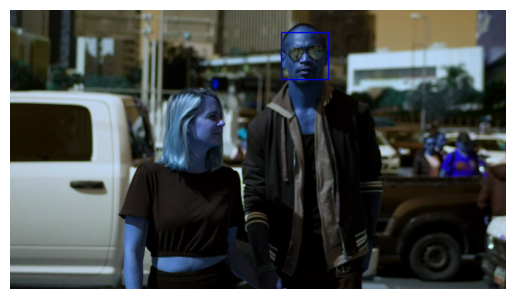

In [7]:
# 準備
# 正面を向いている人を検出する
cascade_file = "../input/100knock-cascadeclassifier/haarcascade_frontalface_alt.xml"
cascade = cv2.CascadeClassifier(cascade_file)

# 検出
img = cv2.imread('../input/100knock-opencv/img02.jpg')
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
face_list = cascade.detectMultiScale(gray, minSize=(50, 50))

# 検出した顔に印を付ける
for (x, y, w, h) in face_list:
    color = (0, 0, 225)
    pen_w = 3
    cv2.rectangle(img, (x, y), (x+w, y+h), color, thickness = pen_w)

    
plt.axis('off')
plt.imshow(img)


# ノック86 : 画像内の人がどこに顔を向けているのか検出する

Dlibライブラリを用いることで顔器官と呼ばれる目・鼻・口・輪郭を68の特異点で表現することができる。

In [8]:
!pip install dlib

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.4/3.4 MB 46.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... - done
  Created wheel for dlib: filename=dlib-19.24.6-cp310-cp310-linux_x86_64.whl size=3374777 sha256=7dc6c6b24f9f726f47aa2107dab7d7bb72c2b1863f0124d0d34b51ea1a29dc46
  Stored in directory: /root/.cache/pip/wheels/7c/1d/d1/e69ceb001441acedfa6156acda6c1856699e260ea1a9e6dcc4
Successfully built dlib


顔方位:0.06456096931747406 (角度:3.6990710631648662度)


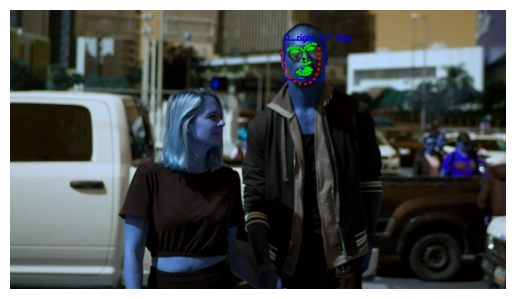

In [9]:
import dlib 
import math

# 準備
predictor = dlib.shape_predictor('../input/100knock-opencv/shape_predictor_68_face_landmarks.dat')
detector = dlib.get_frontal_face_detector()

# 検出
img = cv2.imread('../input/100knock-opencv/img02.jpg')
dets = detector(img, 1)

for k, d in enumerate(dets):
    shape = predictor(img, d)
    
    # 顔領域の表示
    color_f = (0, 0, 225)
    color_l_out = (225, 0, 0)
    color_l_in = (0, 225, 0)
    line_w = 3
    circle_r = 3
    fontType = cv2.FONT_HERSHEY_SIMPLEX
    fontSize = 1
    cv2.rectangle(img, (d.left(), d.top(),), (d.right(), d.bottom()), color_f, line_w)
    cv2.putText(img, str(k), (d.left(), d.top()), fontType, fontSize, color_f, line_w)
    # 重心を導出する箱を用意
    num_of_points_out = 17
    num_of_points_in = shape.num_parts - num_of_points_out
    gx_out = 0
    gy_out = 0
    gx_in = 0
    gy_in = 0
    for shape_point_count in range(shape.num_parts):
        shape_point = shape.part(shape_point_count)
        #print("顔器官No.{} 座標位置: ({},{})".format(shape_point_count, shape_point.x, shape_point.y))
        #器官ごとに描画
        if shape_point_count<num_of_points_out:
            cv2.circle(img,(shape_point.x, shape_point.y),circle_r,color_l_out, line_w)
            gx_out = gx_out + shape_point.x/num_of_points_out
            gy_out = gy_out + shape_point.y/num_of_points_out
        else:
            cv2.circle(img,(shape_point.x, shape_point.y),circle_r,color_l_in, line_w)
            gx_in = gx_in + shape_point.x/num_of_points_in
            gy_in = gy_in + shape_point.y/num_of_points_in

    # 重心位置を描画
    cv2.circle(img,(int(gx_out), int(gy_out)),circle_r,(0,0,255), line_w)
    cv2.circle(img,(int(gx_in), int(gy_in)),circle_r,(0,0,0), line_w)

    # 顔の方位を計算
    theta = math.asin(2*(gx_in-gx_out)/(d.right()-d.left()))
    radian = theta*180/math.pi
    print("顔方位:{} (角度:{}度)".format(theta,radian))

    # 顔方位を表示
    if radian<0:
        textPrefix = "   left "
    else:
        textPrefix = "   right "
    textShow = textPrefix + str(round(abs(radian),1)) + " deg."
    cv2.putText(img, textShow, (d.left(), d.top()), fontType, fontSize, color_f, line_w)

plt.axis('off')
plt.imshow(img)
plt.show()

輪郭の重臣と内側の重心の差から顔の向きを表示しているらしい。（詳しくは専門書で学ぼうとのこと）

# ノック87 : 検出した情報を統合しタイムラプスを作成する

* ### kaggle notebook上でやるとややこしいことになるので飛ばす。

In [10]:
print("タイムラプス生成を開始します")

# 映像取得 #
cap = cv2.VideoCapture("mov/mov01.avi")
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

# hog宣言 #
hog = cv2.HOGDescriptor()
hog.setSVMDetector(cv2.HOGDescriptor_getDefaultPeopleDetector())
hogParams = {'winStride': (8, 8), 'padding': (32, 32), 'scale': 1.05, 'hitThreshold':0, 'groupThreshold':5}

# タイムラプス作成 #
movie_name = "timelapse.avi"
fourcc = cv2.VideoWriter_fourcc('X', 'V', 'I', 'D')
video = cv2.VideoWriter(movie_name,fourcc, 30, (width,height))

num = 0
while(cap.isOpened()):
    ret, frame = cap.read()
    if ret:
        if (num%10==0):
            gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
            human, r = hog.detectMultiScale(gray, **hogParams)
            if (len(human)>0):
                for (x, y, w, h) in human:
                    cv2.rectangle(frame, (x, y), (x + w, y + h), (255,255,255), 3)

            video.write(frame)
    else:
        break
    num = num + 1
video.release()
cap.release()

print("タイムラプス生成を終了しました")

タイムラプス生成を開始します
タイムラプス生成を終了しました


[ WARN:0@696.650] global cap.cpp:643 open VIDEOIO(CV_IMAGES): raised OpenCV exception:

OpenCV(4.10.0) /io/opencv/modules/videoio/src/cap_images.cpp:430: error: (-215:Assertion failed) !filename_pattern.empty() in function 'open'




# ノック88 : 全体像をグラフにして可視化する

人の検出を行った上で、人の数の時系列変化を可視化する

pandasのアップデートによりappendメソッドが使えないので、concatを使用した。

In [11]:
import pandas as pd
print('分析を開始します')
#　映像取得
cap = cv2.VideoCapture('../input/100knock-opencv/mov01.avi')
fps = cap.get(cv2.CAP_PROP_FPS)

# hog宣言 #
hog = cv2.HOGDescriptor()
hog.setSVMDetector(cv2.HOGDescriptor_getDefaultPeopleDetector())
hogParams = {'winStride': (8, 8), 'padding': (32, 32), 'scale': 1.05, 'hitThreshold':0, 'groupThreshold':5}

num = 0
list_df = pd.DataFrame( columns=['time','people'] )
while(cap.isOpened()):
    ret, frame = cap.read()
    if ret:
        if (num%10==0):
            gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
            human, r = hog.detectMultiScale(gray, **hogParams)
            if (len(human)>0):
                for (x, y, w, h) in human:
                    cv2.rectangle(frame, (x, y), (x + w, y + h), (255,255,255), 3)
            tmp_se = pd.Series( [num/fps,len(human) ], index=list_df.columns )
            list_df = pd.concat([list_df, tmp_se.to_frame().T], ignore_index=True)     
    else:
        break
    num = num + 1
cap.release()

print('分析を終了しました。')

分析を開始します


/tmp/ipykernel_17/884818883.py:24: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  list_df = pd.concat([list_df, tmp_se.to_frame().T], ignore_index=True)


分析を終了しました。


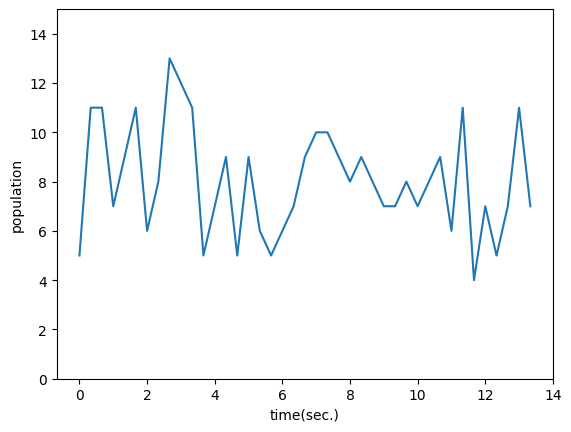

In [12]:
import matplotlib.pyplot as plt
plt.plot(list_df["time"], list_df["people"])
plt.xlabel('time(sec.)')
plt.ylabel('population')
plt.ylim(0,15)
plt.show()

# ノック89 : 人通りの変化をグラフで確認しよう

先ほどと同じコードを使用して、別の動画を読み込んで様子を観察してみる。

In [13]:
print("分析を開始します")
# 映像取得 #
cap = cv2.VideoCapture("../input/100knock-opencv/mov02.avi")
fps = cap.get(cv2.CAP_PROP_FPS)

# hog宣言 #
hog = cv2.HOGDescriptor()
hog.setSVMDetector(cv2.HOGDescriptor_getDefaultPeopleDetector())
hogParams = {'winStride': (8, 8), 'padding': (32, 32), 'scale': 1.05, 'hitThreshold':0, 'groupThreshold':5}

num = 0
list_df2 = pd.DataFrame( columns=['time','people'] )
while(cap.isOpened()):
    ret, frame = cap.read()
    if ret:
        if (num%10==0):
            gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
            human, r = hog.detectMultiScale(gray, **hogParams)
            if (len(human)>0):
                for (x, y, w, h) in human:
                    cv2.rectangle(frame, (x, y), (x + w, y + h), (255,255,255), 3)
            tmp_se = pd.Series( [num/fps,len(human) ], index=list_df.columns )
            list_df2 = pd.concat([list_df2, tmp_se.to_frame().T], ignore_index=True)      
    else:
        break
    num = num + 1
cap.release()
print("分析を終了しました")

分析を開始します


/tmp/ipykernel_17/2738863767.py:23: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  list_df2 = pd.concat([list_df2, tmp_se.to_frame().T], ignore_index=True)


分析を終了しました


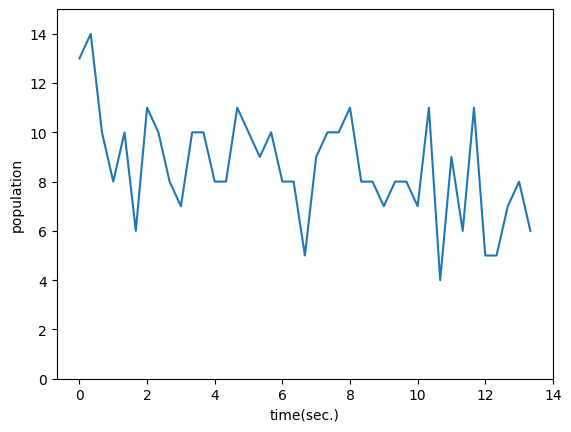

In [14]:
import matplotlib.pyplot as plt
plt.plot(list_df2["time"], list_df2["people"])
plt.xlabel('time(sec.)')
plt.ylabel('population')
plt.ylim(0,15)
plt.show()

先ほどと少し形が異なる。

# ノック90 : 移動平均を計算してノイズを除去する

hogで分析したデータはノイズが多く、誤検出から凹凸の多いグラフになっている。<br>→移動平均を用いてノイズを除去する

* ### 移動平均とは？
[このページを参照。](https://community.jmp.com/t5/JMP-Blog/%E7%A7%BB%E5%8B%95%E5%B9%B3%E5%9D%87%E3%81%AB%E3%81%8A%E3%81%91%E3%82%8B-2%E3%81%A4-%E3%81%AE%E8%A8%88%E7%AE%97%E6%96%B9%E6%B3%95/ba-p/440940)要するに前後のデータと現在のデータの平均をとってプロットする方法みたい。

In [15]:
import numpy as np
def moving_average(x, y):
    y_conv = np.convolve(y, np.ones(5)/float(5), mode='valid')
    x_dat = np.linspace(np.min(x), np.max(x), np.size(y_conv))
    return x_dat, y_conv

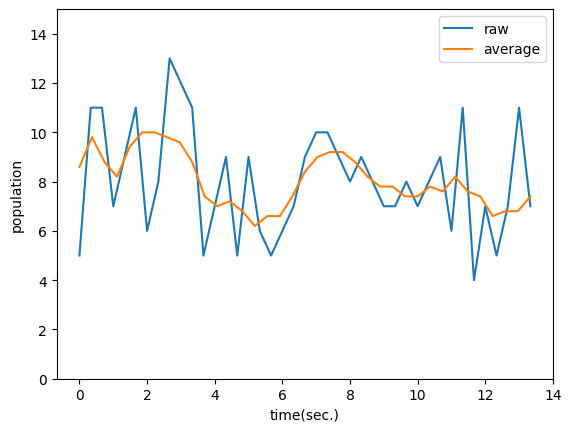

In [16]:
plt.plot(list_df["time"], list_df["people"], label="raw")
ma_x, ma_y = moving_average(list_df["time"], list_df["people"])
plt.plot(ma_x,ma_y, label="average")
plt.xlabel('time(sec.)')
plt.ylabel('population')
plt.ylim(0,15)
plt.legend()
plt.show()

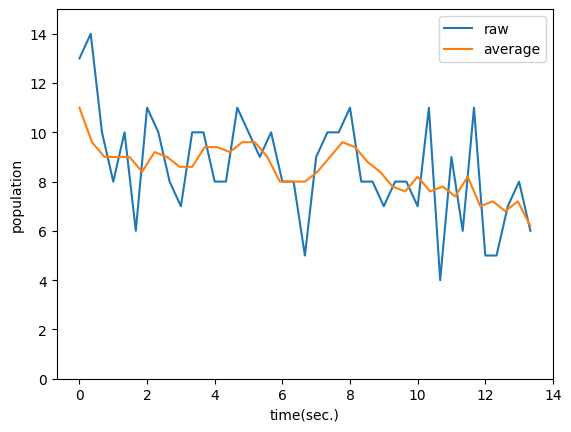

In [17]:
plt.plot(list_df2["time"], list_df2["people"], label="raw")
ma_x2, ma_y2 = moving_average(list_df2["time"], list_df2["people"])
plt.plot(ma_x2,ma_y2, label="average")
plt.xlabel('time(sec.)')
plt.ylabel('population')
plt.ylim(0,15)
plt.legend()
plt.show()

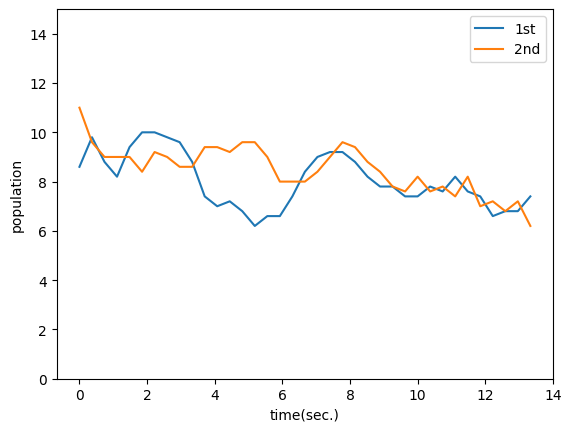

In [18]:
plt.plot(ma_x,ma_y, label="1st")
plt.plot(ma_x2,ma_y2, label="2nd")
plt.xlabel('time(sec.)')
plt.ylabel('population')
plt.ylim(0,15)
plt.legend()
plt.show()